# Housing Unit Allocation with Person Record File Full Workflow

## Overview
This code works with the National Structures Inventory to run the housing unit allocation (HUA) and the person record file (PREC) workflow.
The HUA process is generalizable to any county in the United States. The HUA process will work for any file that has locations of structures and some basic information about the buildings.
The process is designed to work with [IN-CORE](https://incore.ncsa.illinois.edu/), a community resilience modeling environment.
Using IN-CORE requires an account and access to the IN-CORE Dataservice.

Functions are provided to obtain and clean data required for the version 2 Housing Unit Allocation. 

## Required Inputs
Program requires the following inputs:
If using the National Structures Inventory there are no required inputs.
    
## Output Description
The output of this workflow is a CSV file with the housing unit inventory allocated to a building inventory using the housing unit allocation model.

The output CSV is designed to be used in the Interdependent Networked Community Resilience Modeling Environment (IN-CORE).

IN-CORE is an open source python package that can be used to model the resilience of a community. To download IN-CORE, see:

https://incore.ncsa.illinois.edu/


## Instructions
Users can run the workflow by executing each block of code in the notebook.

## Description of Program
- program:    ncoda_07fv1_HUA_PREC_NSI
- task:       Start with NSI building inventory, run housing unit allocation algorithm, and then run person record file algorithm
- See github commits for description of program updates
- Current Version: v1 - 
- 2024-02-20 - Combine code from 07c, 07d, and 07e into one notebook
- 2024-05-22 - removed the drop down menu, did not work consistently
- project:    Interdependent Networked Community Resilience Modeling Environment (IN-CORE), Subtask 5.2 - Social Institutions
- funding:	  NIST Financial Assistance Award Numbers: 70NANB15H044 and 70NANB20H008 
- author:     Nathanael Rosenheim

## Required Citations:
Rosenheim, Nathanael, Roberto Guidotti, Paolo Gardoni & Walter Gillis Peacock. (2021). Integration of detailed household and housing unit characteristic data with critical infrastructure for post-hazard resilience modeling. _Sustainable and Resilient Infrastructure_. 6(6), 385-401. https://doi.org/10.1080/23789689.2019.1681821

Rosenheim, Nathanael (2021) “Detailed Household and Housing Unit Characteristics: Data and Replication Code.” _DesignSafe-CI_. 
https://doi.org/10.17603/ds2-jwf6-s535.

In [5]:
# To reload submodules need to use this magic command to set autoreload on
%load_ext autoreload
%autoreload 2
from pyncoda.ncoda_00g_community_options import *
from IPython.display import display

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### How to set up the Community Dictionary
Please review the python code in the file pyncoda/ncoda_00g_community_options.py

In this file you will find a collection of data dictionaries with various ways to setup the inputs for the Housing Unit Allocation process. 

The basic dictionary includes the name of the community, the county FIPS code, your input building inventory file, and key variables in the building inventory file.

In [6]:
# select a community from this list
# if your community is not in this list, add it to the file ncoda_00g_community_options.py
list_community_options(communities_dictionary)

['Lumberton, NC: IN-CORE Building inventory for Robeson County, NC',
 'Galveston, TX: IN-CORE Building inventory for Galveston County, TX',
 'Galveston, TX: NSI Building inventory for Galveston County, TX',
 'Galveston, TX: IN-CORE Building inventory for Galveston Island, TX',
 'Mayfield, KY: NSI Building inventory for Graves County, KY',
 'Beaumont, TX: NSI Building inventory for Jefferson County, TX',
 'Beaumont, TX: Safayet Building inventory for Jefferson County, TX',
 'Pentwater, MI: NSI Building inventory for Oceana County, MI',
 'Seaside, OR: NSI Building inventory for Clatsop County, OR',
 'Lane County, OR: NSI Building inventory for Lane County, OR',
 'Benton County, OR: NSI Building inventory for Benton County, OR',
 'Southeast Texas Urban Integrated Field Lab: NSI Building inventory for Southeast Texas',
 'Brazos County, TX: NSI Building inventory for Brazos County, TX']

In [7]:
community_id_by_name = 'Brazos County, TX: NSI Building inventory for Brazos County, TX'

In [8]:
community_id, focalplace, countyname, countyfips = get_community_id_by_name(community_id_by_name)
communities = {community_id : communities_dictionary[community_id]}

Selected community ID: Brazos_TX_NSI
Brazos County, TX is in TEXAS
Focal place: Bryan
Brazos County, TX is in Brazos County, TX with FIPS code 48041
Use IN-CORE: False


## Setup Python Environment

In [9]:
import pandas as pd
import geopandas as gpd # For reading in shapefiles
import numpy as np
import sys # For displaying package versions
import os # For managing directories and file paths if drive is mounted
import scooby # Reports Python environment

import contextily as cx # For adding basemap tiles to plot
import matplotlib.pyplot as plt # For plotting and making graphs

In [10]:
# open, read, and execute python program with reusable commands
from pyncoda.ncoda_00d_cleanvarsutils import *
from pyncoda.ncoda_04c_poptableresults import *
from pyncoda.ncoda_07i_process_communities import process_community_workflow

In [11]:
# Generate report of Python environment
base_packages = ['pandas','ipyleaflet','seaborn','contextily']
incore_packages = ['pyincore','pyincore_viz']
check_packages = base_packages + incore_packages
print(scooby.Report(additional=check_packages))


--------------------------------------------------------------------------------
  Date: Thu Jun 20 02:45:23 2024 UTC

                OS : Linux (Ubuntu 20.04)
            CPU(s) : 4
           Machine : x86_64
      Architecture : 64bit
               RAM : 15.6 GiB
       Environment : Jupyter

  Python 3.10.13 (main, May 30 2024, 20:38:07) [GCC 9.4.0]

            pandas : 2.2.2
        ipyleaflet : Module not found
           seaborn : 0.13.2
        contextily : 1.6.0
          pyincore : Module not found
      pyincore_viz : Module not found
             numpy : 1.26.4
             scipy : 1.13.1
           IPython : 8.24.0
        matplotlib : 3.8.4
            scooby : 0.10.0
--------------------------------------------------------------------------------


In [12]:
# Check working directory - good practice for relative path access
os.getcwd()

'/workspaces/intersect-community-data'

## Run Housing Unit Allocation
The following code will produce the following outputs:
1. Housing Unit Inventory
2. Address Point Inventory
3. Housing Unit Allocation

Creating folder OutputData/Brazos_TX_NSI to store output.
Creating folder OutputData/Brazos_TX_NSI/00_logfiles
     logfiles Folder purpose: Store text files with log of workflow.
Creating folder OutputData/Brazos_TX_NSI/01_CommunitySourceData
     CommunitySourceData Folder purpose: Source source data files. Helps with software development and replication.
Creating folder OutputData/Brazos_TX_NSI/02_TidyCommunitySourceData
     TidyCommunitySourceData Folder purpose: Cleaned source data and inputs for base inventory.
Creating folder OutputData/Brazos_TX_NSI/03_BaseInventory
     BaseInventory Folder purpose: Initial inventories before random merge. Use as inputs to uncertainty propagation.
Creating folder OutputData/Brazos_TX_NSI/04_RandomMerge
     RandomMerge Folder purpose: Results of random merge with flag columns.
Creating folder OutputData/Brazos_TX_NSI/05_Verify
     Verify Folder purpose: Results to compare inventories with source data.
Creating folder OutputData/Brazos_TX_NSI

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_01a_BaseInventory.py:1014: FutureWarning: The provided callable <function sum at 0x7693d80a51b0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  total_sum_df = pd.pivot_table(df, values=values_to_sum, index=by_vars,


Merge vars for familybyP18_counter = ['Block2010str', 'race', 'hispan']
Updating flags based on hucount_familybyP18updated
Length of Set1 split dataframe 25073
Length of Not Set split dataframe 13407
Length of familybyP18 split dataframe 14879
Length of familybyP18_counter split dataframe 24380


Shape of dataframe after total sum: (77739, 20)
['prob_familybyP18']
familybyP18
Base Housing Unit Inventory has new characteristic hispan
Graft process will predict missing values of  hispan

***************************************
    Base Inventory has 17188 observations not set
***************************************


***************************************
    Predicting hispan based on ['numprec', 'ownershp', 'hispanbyH16HAI', 'byracehispan'] ['numprec', 'ownershp'] H16HAI
***************************************


***************************************
    Base Inventory has 17188 observations not set
***************************************

['numprec', 'ownershp', 'hispanbyH16HAI', 'b

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_01a_BaseInventory.py:1014: FutureWarning: The provided callable <function sum at 0x7693d80a51b0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  total_sum_df = pd.pivot_table(df, values=values_to_sum, index=by_vars,



**********************************
Reshape dataframe to convert unit of analysis
   For mutually exclusive dataframe for: HISPANIC OR LATINO ORIGIN OF HOUSEHOLDER BY RACE OF HOUSEHOLDER
       Unit of analysis converted from 3611 block s, to 3124 household
hispanbyH007
Fill missing values with 0

***************************************
    Predicting hispan based on ['ownershp', 'hispanbyH015'] ['ownershp'] H15
***************************************


***************************************
    Base Inventory has 3111 observations not set
***************************************

['ownershp', 'hispanbyH015']

**********************************
Obtain data from Census API TENURE BY HISPANIC OR LATINO ORIGIN OF HOUSEHOLDER
    Obtaining data for H015 TENURE BY HISPANIC OR LATINO ORIGIN OF HOUSEHOLDER by Race and Hispanic Not Applicable
       Census API data from: https://api.census.gov/data/2010/dec/sf1?get=GEO_ID,H015004,H015007&in=state:48&in=county:041&for=block:*


/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_01a_BaseInventory.py:1014: FutureWarning: The provided callable <function sum at 0x7693d80a51b0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  total_sum_df = pd.pivot_table(df, values=values_to_sum, index=by_vars,



**********************************
Reshape dataframe to convert unit of analysis
   For mutually exclusive dataframe for: TENURE BY HISPANIC OR LATINO ORIGIN OF HOUSEHOLDER
       Unit of analysis converted from 3611 block s, to 2474 household
hispanbyH015
Fill missing values with 0
['Block2010str', 'numprec', 'ownershp']
Updating hispanbyH16HAI_counter  based on total probability and ['Block2010str', 'numprec', 'ownershp']
['Block2010str', 'race']
Updating hispanbyH007_counter  based on total probability and ['Block2010str', 'race']
['Block2010str', 'ownershp']
Updating hispanbyH015_counter  based on total probability and ['Block2010str', 'ownershp']
Merge vars for hispanbyH16HAI_counter = ['Block2010str', 'numprec', 'ownershp']
Updating flags based on hucount_hispanbyH16HAIupdated
Merge vars for hispanbyH007_counter = ['Block2010str', 'race']
Updating flags based on hucount_hispanbyH007updated
Merge vars for hispanbyH015_counter = ['Block2010str', 'ownershp']
Updating flags based on

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_01a_BaseInventory.py:1014: FutureWarning: The provided callable <function sum at 0x7693d80a51b0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  total_sum_df = pd.pivot_table(df, values=values_to_sum, index=by_vars,


hispanbyH007
hispanbyH015
{'top': 'OutputData/Brazos_TX_NSI', 'logfiles': 'OutputData/Brazos_TX_NSI/00_logfiles', 'CommunitySourceData': 'OutputData/Brazos_TX_NSI/01_CommunitySourceData', 'TidyCommunitySourceData': 'OutputData/Brazos_TX_NSI/02_TidyCommunitySourceData', 'BaseInventory': 'OutputData/Brazos_TX_NSI/03_BaseInventory', 'RandomMerge': 'OutputData/Brazos_TX_NSI/04_RandomMerge', 'Verify': 'OutputData/Brazos_TX_NSI/05_Verify', 'Explore': 'OutputData/Brazos_TX_NSI/06_Explore', 'Uncertainty_propagation': 'OutputData/Brazos_TX_NSI/07_Uncertainty_propagation', 'Validation': 'OutputData/Brazos_TX_NSI/08_Validation'}
['byracehispan', 'incomegroup']

**********************************
Obtain data from Census API HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 2012 INFLATION-ADJUSTED DOLLARS)
    Obtaining data for B19001_ HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 2012 INFLATION-ADJUSTED DOLLARS) by Total
       Census API data from: https://api.census.gov/data/2012/acs/acs5?get=GEO_ID,B190

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_02a_add_categorical_char.py:760: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  set_flag_df.loc[conditions, self.flaggeo_var] = .5


After Recombine flag set 3 = 0

***************************************
   Generate output data
***************************************

Flag vars available ['family_flagsetrm', 'family_Tract2010_flagsetrm', 'family_County2010_flagsetrm']
Before update output_df observations flag set 3 = 0
Before update results observations flag set 3 = 0
After update observations geovar flag set 3 = 0

***************************************
    Check random merge results for primary data.
***************************************

Check by geovar flag family_County2010_flagsetrm
Observations flag not equal to 0 40829
Input and output data have the same length 72197
Outputdata has 40829 Observations with predicted family
Percent left to predict: 43.45

***************************************
    Overwrite input data with update output data.
***************************************

Flag vars available ['family_flagsetrm', 'family_Tract2010_flagsetrm', 'family_County2010_flagsetrm']
Before update output_d

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_02a_add_categorical_char.py:760: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  set_flag_df.loc[conditions, self.flaggeo_var] = .5


Confirming County2010 has expected length.
Longest County2010 : 48041
County2010 Expected Length 5 Available Length 5
Checking primary key name uniqueidB19001
Primary key variable uniqueidB19001 is unique.
Primary key uniqueidB19001 has no missing values
['uniqueidB19001', 'County2010', 'Tract2010', 'index', 'GEO_ID', 'state', 'county', 'tract', 'race', 'hispan', 'hu_counter', 'family', 'incomegroup', 'family_flagsetrm', 'family_Tract2010_flagsetrm', 'family_County2010_flagsetrm', 'incomegroup_flagsetrm', 'incomegroup_Tract2010_flagsetrm']
Initializing geovar flag set variable for incomegroup at geolevel County2010
New flag: incomegroup_County2010_flagsetrm
Observations without primary flag set 2878
Observations without geovar flag set 72197
After updated observations without geovar flag set 2878
Setting 2878 flags for incomegroup secondary data not used.
0 observations do not have required variable County2010
0 observations do not have required variable hispan
0 observations do not ha

/workspaces/intersect-community-data/pyncoda/ncoda_07a_generate_hui.py:170: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  hui_incore_df_fixed = hui_incore_df.applymap(lambda cell: int(cell) if str(cell).endswith('.0') else cell)


Housing Unit Inventory Codebook for Brazos County, TX, 2010
Adding first figure to cover page: randincome_by_race48041.png
OutputData/Brazos_TX_NSI/06_Explore/randincome_by_race48041.png

huid
huid: Housing Unit ID
blockid
blockid: Block ID
bgid
bgid: 2010 Census Block Group ID
tractid
tractid: 2010 Census Tract ID
FIPScounty
FIPScounty: County FIPS Code
numprec
numprec: Number of Person Records
ownershp
ownershp: Tenure Status
6
ownershp: Tenure Status - Categorical codes, labels and frequencies
race
race: Race of Householder
6
race: Race of Householder - Categorical codes, labels and frequencies
hispan
hispan: Hispanic Householder
6
hispan: Hispanic Householder - Categorical codes, labels and frequencies
family
family: Family Household
6
family: Family Household - Categorical codes, labels and frequencies
vacancy
vacancy: Vacancy Type
6
vacancy: Vacancy Type - Categorical codes, labels and frequencies
gqtype
gqtype: Group Quarters Type
6
gqtype: Group Quarters Type - Categorical code

/workspaces/intersect-community-data/pyncoda/ncoda_00e_geoutilities.py:294: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4815976' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  copy_point_gdf.loc[precise_matches.index,geolevel+col] = polygon[col]
/workspaces/intersect-community-data/pyncoda/ncoda_00e_geoutilities.py:294: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'College Station' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  copy_point_gdf.loc[precise_matches.index,geolevel+col] = polygon[col]


.....................................40886 Buildings have Residential Archetype RES1-1SNB
2207 Buildings have Residential Archetype RES1-1SWB
4926 Buildings have Residential Archetype RES1-2SNB
249 Buildings have Residential Archetype RES1-2SWB
832 Buildings have Residential Archetype RES1-3SNB
58 Buildings have Residential Archetype RES1-3SWB
0 Buildings have Residential Archetype RES1-SLNB
0 Buildings have Residential Archetype RES1-SLWB
0 Buildings have Residential Archetype RES1
4342 Buildings have Residential Archetype RES2
7139 Buildings have Residential Archetype RES3A
1159 Buildings have Residential Archetype RES3B
321 Buildings have Residential Archetype RES3C
47 Buildings have Residential Archetype RES3D
74 Buildings have Residential Archetype RES3E
19 Buildings have Residential Archetype RES3F
77 Buildings have Residential Archetype RES4
12 Buildings have Residential Archetype RES5
41 Buildings have Residential Archetype RES6
81 Buildings have building_area_var less than 300

/workspaces/intersect-community-data/pyncoda/ncoda_07c_generate_addpt.py:785: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  applymap(lambda cell: int(cell) if str(cell).endswith('.0') else cell)


Longest Block ID: 999999999999999
Shortest Block ID: 999999999999999
Not using IN-CORE. Dataset_id is the dataframe
The Address Point Inventory ID contains a pandas dataframe
Housing Unit Allocation for: Brazos_TX_NSI
Based on building inventory: NSI
Running up Housing Unit Allocation for Brazos_TX_NSI

***************************************
    Run Housing Unit Allocation for Brazos_TX_NSI
***************************************


***************************************
    Merge housing unit and address point data with first 3 counters.
***************************************

Round 1

***************************************
***************************************

Performing random merge at geography level: Block

***************************************
***************************************


***************************************
***************************************

Attempt to merge hui on all common group vars.

***************************************
*********************

/workspaces/intersect-community-data/pyncoda/ncoda_07d_run_hua_workflow.py:173: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[1.5 1.5 1.5 ... 1.5 1.5 1.5]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  addptv2_df.loc[condition1 & condition2 & condition3,'ownershp1'] \


Primary key variable huid is unique.
Primary key huid has no missing values
['huid', 'Block2010', 'blockid', 'bgid', 'tractid', 'FIPScounty', 'numprec', 'ownershp', 'race', 'hispan', 'family', 'vacancy', 'gqtype', 'incomegroup', 'hhinc', 'randincome', 'poverty', 'BLOCKID10_str', 'huicounter1', 'huicounter2', 'huicounter3', 'ownershp1', 'ownershp2', 'ownershp3', 'strctid', 'strctid_flagsetrm', 'strctid_Block2010_flagsetrm', 'addrptid', 'fd_id_bid', 'huestimate', 'huicounter_addpt', 'placeNAME10', 'x', 'y']
Observations without primary flag set 24697
Observations without geovar flag set 24697
After updated observations without geovar flag set 24697
Setting 0 flags for strctid set before random merge.
0 observations do not have required variable Block2010
0 observations do not have required variable huicounter3
0 observations do not have required variable ownershp1
Setting 0 flags for observations without required variable Block2010
Setting 0 flags for observations without required variab

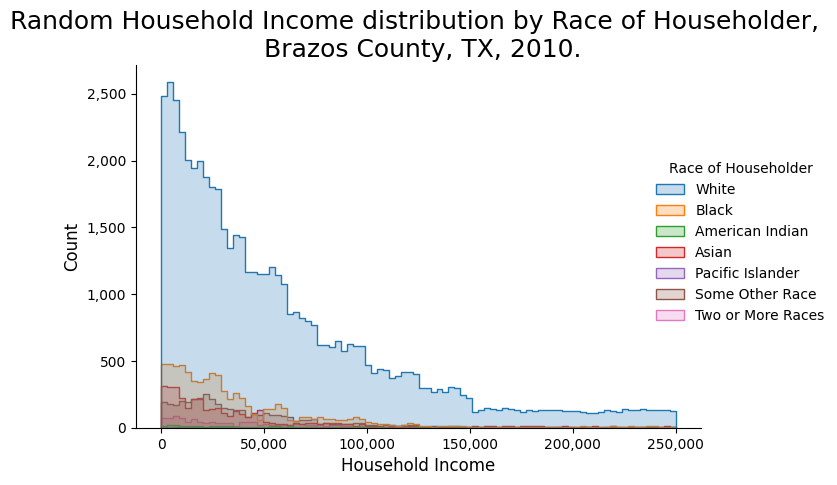

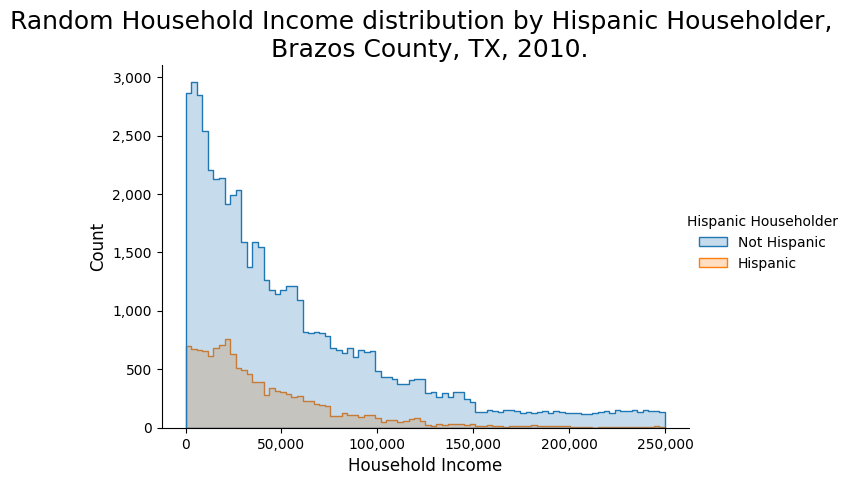

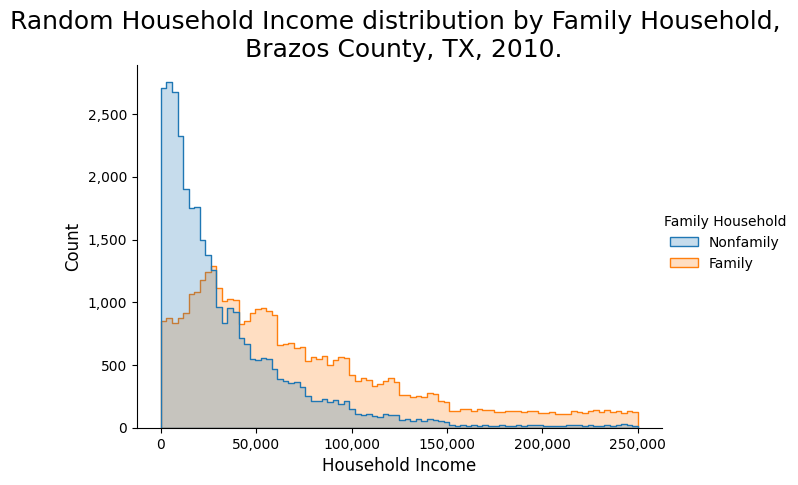

In [13]:
workflow = process_community_workflow(communities)
hua_hui_gdf = workflow.process_communities()

## Run Person Record File

In [14]:
version = '3.0.0'
version_text = 'v3-0-0'

# open, read, and execute python program with reusable commands
from pyncoda.ncoda_07e_generate_prec import generate_prec_functions

# Save Outputfolder - due to long folder name paths output saved to folder with shorter name
# files from this program will be saved with the program name - 
# this helps to follow the overall workflow
outputfolder = "OutputData"
# Make directory to save output
if not os.path.exists(outputfolder):
    os.mkdir(outputfolder)

# Set random seed for reproducibility
seed = 1000
basevintage = 2010

generate_prec_df = generate_prec_functions(
                    communities =   communities,
                    seed =          seed,
                    version =       version,
                    version_text=   version_text,
                    basevintage=    basevintage,
                    outputfolder=   outputfolder
                    )

prec_df = generate_prec_df.generate_prec_v300()

Generating Person Record File v3.0.0 data for Brazos County, TX
Brazos County, TX : county FIPS Code 48041

***************************************
    Version control - list of installed packages
***************************************

Unable to print version information

***************************************
    Obtain and clean core person record characteristics for Brazos County, TX
***************************************

{'top': 'OutputData/Brazos_TX_NSI', 'logfiles': 'OutputData/Brazos_TX_NSI/00_logfiles', 'CommunitySourceData': 'OutputData/Brazos_TX_NSI/01_CommunitySourceData', 'TidyCommunitySourceData': 'OutputData/Brazos_TX_NSI/02_TidyCommunitySourceData', 'BaseInventory': 'OutputData/Brazos_TX_NSI/03_BaseInventory', 'RandomMerge': 'OutputData/Brazos_TX_NSI/04_RandomMerge', 'Verify': 'OutputData/Brazos_TX_NSI/05_Verify', 'Explore': 'OutputData/Brazos_TX_NSI/06_Explore', 'Uncertainty_propagation': 'OutputData/Brazos_TX_NSI/07_Uncertainty_propagation', 'Validation': 'OutputD

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_01a_BaseInventory.py:1014: FutureWarning: The provided callable <function sum at 0x7693d80a51b0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  total_sum_df = pd.pivot_table(df, values=values_to_sum, index=by_vars,



**********************************
Reshape dataframe to convert unit of analysis
   For mutually exclusive dataframe for: HISPANIC OR LATINO ORIGIN BY RACE
       Unit of analysis converted from 3611 block s, to 3931 person
hispanbyP5
Fill missing values with 0
['Block2010str', 'sex', 'minageyrs', 'maxageyrs']
Updating hispanbyP12HAI_counter  based on total probability and ['Block2010str', 'sex', 'minageyrs', 'maxageyrs']
['Block2010str', 'race']
Updating hispanbyP5_counter  based on total probability and ['Block2010str', 'race']
Merge vars for hispanbyP12HAI_counter = ['Block2010str', 'sex', 'minageyrs', 'maxageyrs']
Updating flags based on preccount_hispanbyP12HAIupdated
Merge vars for hispanbyP5_counter = ['Block2010str', 'race']


/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_01a_BaseInventory.py:1014: FutureWarning: The provided callable <function sum at 0x7693d80a51b0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  total_sum_df = pd.pivot_table(df, values=values_to_sum, index=by_vars,


Updating flags based on preccount_hispanbyP5updated
Length of Set1 split dataframe 142814
Length of Not Set split dataframe 9184
Length of hispanbyP12HAI split dataframe 26486
Length of hispanbyP5 split dataframe 12741
Length of hispanbyP12HAI_counter split dataframe 3453
Length of hispanbyP5_counter split dataframe 173


Shape of dataframe after total sum: (194851, 24)
['prob_hispanbyP12HAI', 'prob_hispanbyP5']
hispanbyP12HAI
hispanbyP5
Dictionary file OutputData/00_datastructures/api_census_gov/PCT12_2010_datastructurev0-2-0.txt Already exists - Skipping API Call.
{'top': 'OutputData/Brazos_TX_NSI', 'logfiles': 'OutputData/Brazos_TX_NSI/00_logfiles', 'CommunitySourceData': 'OutputData/Brazos_TX_NSI/01_CommunitySourceData', 'TidyCommunitySourceData': 'OutputData/Brazos_TX_NSI/02_TidyCommunitySourceData', 'BaseInventory': 'OutputData/Brazos_TX_NSI/03_BaseInventory', 'RandomMerge': 'OutputData/Brazos_TX_NSI/04_RandomMerge', 'Verify': 'OutputData/Brazos_TX_NSI/05_Verify', 'Explore': 'Out

/workspaces/intersect-community-data/pyncoda/CommunitySourceData/api_census_gov/acg_02a_add_categorical_char.py:783: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  set_flag_df.loc[conditions, self.flaggeo_var] = self.round+.5


After update observations geovar flag set 1 = 194851

***************************************
    Check random merge results for primary data.
***************************************

Check by geovar flag randagePCT12_Tract2010_flagsetrm
Observations flag not equal to 0 194851
Input and output data have the same length 194851
Outputdata has 194851 Observations with predicted randagePCT12
Percent left to predict:  0.00

***************************************
    Overwrite input data with update output data.
***************************************

Flag vars available ['randagePCT12_flagsetrm', 'randagePCT12_Tract2010_flagsetrm']
Before update output_df observations flag set 1 = 0
Before update results observations flag set 1 = 194851
After update observations geovar flag set 1 = 194851

***************************************
    Check random merge results for secondary data.
***************************************

Check by geovar flag randagePCT12_Tract2010_flagsetrm
Observations fla

/workspaces/intersect-community-data/pyncoda/ncoda_07e_generate_prec.py:120: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  prec_df_fixed = prec_df.applymap(lambda cell: int(cell) if str(cell).endswith('.0') else cell)


## Explore and Validate Housing Unit Allocation


### Look at population characteristics and compare to US Census

In [15]:
where = communities[community_id]['community_name']
print(where, focalplace, countyname, countyfips)

Brazos County, TX Bryan Brazos County, TX 48041


In [16]:
# add race ethnicity to data frame for better map legends
hua_hui_race_gdf = PopResultsTable.add_race_ethnicity_to_pop_df(hua_hui_gdf)
hua_hui_race_gdf = PopResultsTable.add_hhinc_df(hua_hui_gdf)

# add category for missing building id
bldg_uniqueid = communities[community_id]['building_inventory']['bldg_uniqueid']
# add category for missing building id
buildingdata_conditions = {'cat_var' : {'variable_label' : 'Building Data Availability',
                         'notes' : 'Does Housing Unit have building data?'},
              'condition_list' : {
                1 : {'condition': f"(df['{bldg_uniqueid}'] == 'missing building id')", 'value_label': "0 Missing Building Data"},
                2 : {'condition': f"(df['{bldg_uniqueid}'] != 'missing building id')", 'value_label': "1 Building Data Available"}}
            }
hua_hui_gdf = add_label_cat_conditions_df(hua_hui_gdf, conditions = buildingdata_conditions)

0 Missing Building Data had 9747 observations
1 Building Data Available had 67992 observations


In [17]:
hua_hui_gdf.head()

,huid,blockid,bgid,tractid,FIPScounty,numprec,ownershp,race,hispan,family,...,fd_id_bid,placeNAME10,huestimate,x,y,geometry,Race Ethnicity,Household Income Group,Building Data Availability_int,Building Data Availability_str
0,B480410001011003H0001,480410001011003,480410001011,48041000101,48041,1,1,1.0,0.0,0,...,nsi-479618781-8625QP9F+WVG-4-3-4-3,Unincorporated,1.0,-96.275282,30.769813,POINT (-96.27528 30.76981),"1 White alone, Not Hispanic","4 $75,000 to $99,999",2.0,1 Building Data Available
1,B480410001011003H0002,480410001011003,480410001011,48041000101,48041,1,1,1.0,0.0,0,...,nsi-479618771-8625QP9F+RQG-4-3-4-4,Unincorporated,1.0,-96.275558,30.769564,POINT (-96.27556 30.76956),"1 White alone, Not Hispanic","1 Less than $15,000",2.0,1 Building Data Available
2,B480410001011003H0003,480410001011003,480410001011,48041000101,48041,1,1,1.0,0.0,0,...,nsi-479618788-8625QPCG+FFQ-5-3-4-3,Unincorporated,1.0,-96.273765,30.771217,POINT (-96.27376 30.77122),"1 White alone, Not Hispanic","1 Less than $15,000",2.0,1 Building Data Available
3,B480410001011003H0022,480410001011003,480410001011,48041000101,48041,1,2,1.0,0.0,0,...,nsi-479618749-8625QP9F+9QQ-4-3-4-3,Unincorporated,1.0,-96.275509,30.768461,POINT (-96.27551 30.76846),"1 White alone, Not Hispanic","3 $25,000 to $74,999",2.0,1 Building Data Available
4,B480410001011004H0001,480410001011004,480410001011,48041000101,48041,1,1,1.0,0.0,0,...,nsi-479725894-8625QP78+H56-3-4-4-3,Unincorporated,1.0,-96.284603,30.763907,POINT (-96.28460 30.76391),"1 White alone, Not Hispanic","3 $25,000 to $74,999",2.0,1 Building Data Available


In [18]:
# set dataframe for focal place
focalplace_hua_hui_gdf =  hua_hui_gdf.loc[hua_hui_gdf['placeNAME10'] == focalplace].copy(deep=True)

In [19]:
PopResultsTable.pop_results_table(
                  input_df = hua_hui_gdf, 
                  who = "Total Population by Households", 
                  what = "by Race, Ethnicity",
                  where = countyname,
                  when = "2010",
                  row_index = "Race Ethnicity",
                  col_index = 'Tenure Status')

Tenure Status,1 Owner Occupied (%),2 Renter Occupied (%),Total Population by Households (%)
Race Ethnicity,,,
"1 White alone, Not Hispanic","58,906 (66.3%)","50,166 (54.8%)","109,072 (60.5%)"
"2 Black alone, Not Hispanic","6,748 (7.6%)","11,177 (12.2%)","17,925 (9.9%)"
"3 American Indian and Alaska Native alone, Not Hispanic",231 (0.3%),199 (0.2%),430 (0.2%)
"4 Asian alone, Not Hispanic","2,760 (3.1%)","6,119 (6.7%)","8,879 (4.9%)"
"5 Other Race, Not Hispanic",675 (0.8%),796 (0.9%),"1,471 (0.8%)"
"6 Any Race, Hispanic","19,572 (22.0%)","23,039 (25.2%)","42,611 (23.6%)"
Total,"88,892 (100.0%)","91,496 (100.0%)","180,388 (100.0%)"


In [20]:
PopResultsTable.pop_results_table(
                  input_df = hua_hui_gdf, 
                  who = "Total Population by Households", 
                  what = "by Race, Ethnicity",
                  where = countyname,
                  when = "2010",
                  row_index = "Race Ethnicity",
                  col_index = 'Hispanic')

Hispanic,0 Not Hispanic or Latino (%),1 Hispanic or Latino (%),Total Population by Households (%)
Race Ethnicity,,,
"1 White alone, Not Hispanic","109,072 (79.2%)",nan (nan%),"109,072 (60.5%)"
"2 Black alone, Not Hispanic","17,925 (13.0%)",nan (nan%),"17,925 (9.9%)"
"3 American Indian and Alaska Native alone, Not Hispanic",430 (0.3%),nan (nan%),430 (0.2%)
"4 Asian alone, Not Hispanic","8,879 (6.4%)",nan (nan%),"8,879 (4.9%)"
"5 Other Race, Not Hispanic","1,471 (1.1%)",nan (nan%),"1,471 (0.8%)"
"6 Any Race, Hispanic",nan (nan%),"42,611 (100.0%)","42,611 (23.6%)"
Total,"137,777 (100.0%)","42,611 (100.0%)","180,388 (100.0%)"


In [21]:
PopResultsTable.pop_results_table(
                  input_df = prec_df, 
                  who = "Total Population by Persons", 
                  what = "by Race, Ethnicity",
                  where = countyname,
                  when = "2010",
                  row_index = "Race",
                  col_index = 'Hispanic')

Hispanic,0 Not Hispanic or Latino (%),1 Hispanic or Latino (%),Total Population by Persons (%)
Race,,,
1. White,"115,252 (77.2%)","27,562 (60.5%)","142,814 (73.3%)"
2. Black or African American,"20,830 (14.0%)",584 (1.3%),"21,414 (11.0%)"
3. American Indian and Alaska Native,458 (0.3%),407 (0.9%),865 (0.4%)
4. Asian,"9,977 (6.7%)",106 (0.2%),"10,083 (5.2%)"
5. Native Hawaiian and Other Pacific Islander,82 (0.1%),37 (0.1%),119 (0.1%)
6. Some Other Race,202 (0.1%),"14,795 (32.5%)","14,997 (7.7%)"
7. Two or More Races,"2,472 (1.7%)","2,087 (4.6%)","4,559 (2.3%)"
Total,"149,273 (100.0%)","45,578 (100.0%)","194,851 (100.0%)"


In [22]:
PopResultsTable.pop_results_table(hua_hui_gdf, 
                  who = "Total Population by Households", 
                  what = "by Race, Ethnicity",
                  where = where,
                  when = "2010",
                  row_index = "Race Ethnicity",
                  col_index = 'Building Data Availability_str',
                  row_percent = '0 Missing Building Data')

Building Data Availability_str,0 Missing Building Data (%),1 Building Data Available (%),Total Population by Households (%),Percent Row 0 Missing Building Data
Race Ethnicity,,,,
"1 White alone, Not Hispanic","10,104 (55.4%)","98,968 (61.0%)","109,072 (60.5%)",9.3%
"2 Black alone, Not Hispanic","1,708 (9.4%)","16,217 (10.0%)","17,925 (9.9%)",9.5%
"3 American Indian and Alaska Native alone, Not Hispanic",40 (0.2%),390 (0.2%),430 (0.2%),9.3%
"4 Asian alone, Not Hispanic","2,624 (14.4%)","6,255 (3.9%)","8,879 (4.9%)",29.6%
"5 Other Race, Not Hispanic",208 (1.1%),"1,263 (0.8%)","1,471 (0.8%)",14.1%
"6 Any Race, Hispanic","3,556 (19.5%)","39,055 (24.1%)","42,611 (23.6%)",8.3%
Total,"18,240 (100.0%)","162,148 (100.0%)","180,388 (100.0%)",10.1%


In [40]:
try:
    print("Attempting to generate the population results table...")
    table1 = PopResultsTable.pop_results_table(
        focalplace_hua_hui_gdf,
        who="Total Population by Households",
        what="by Tenure",
        where=focalplace,
        when="2010",
        row_index="Tenure Status",
        col_index="Building Data Availability_str",
        row_percent="0 Missing Building Data"
    )
    print("Population results table generated successfully.")
except Exception as e:
    table1 = "no table generated"
    print(f"No Missing Building Data: {e}")

table1

Attempting to generate the population results table...
Population results table generated successfully.


Building Data Availability_str,0 Missing Building Data (%),1 Building Data Available (%),Total Population by Households (%),Percent Row 0 Missing Building Data
Tenure Status,,,,
1 Owner Occupied,40 (1.4%),"37,114 (53.4%)","37,154 (51.3%)",0.1%
2 Renter Occupied,"2,873 (98.6%)","32,409 (46.6%)","35,282 (48.7%)",8.1%
Total,"2,913 (100.0%)","69,523 (100.0%)","72,436 (100.0%)",4.0%


In [24]:
PopResultsTable.pop_results_table(hua_hui_gdf, 
                   who = "Median Household Income", 
                  what = "by Race, Ethnicity",
                  where = where,
                  when = "2010",
                  row_index = "Race Ethnicity",
                  col_index = 'Tenure Status')

Tenure Status,1 Owner Occupied,2 Renter Occupied,Median Household Income
Race Ethnicity,,,
"1 White alone, Not Hispanic","$61,556","$27,875","$44,111"
"2 Black alone, Not Hispanic","$33,490","$24,473","$26,688"
"3 American Indian and Alaska Native alone, Not Hispanic","$55,254","$36,678","$49,496"
"4 Asian alone, Not Hispanic","$73,068","$18,400","$24,830"
"5 Other Race, Not Hispanic","$65,520","$36,273","$43,838"
"6 Any Race, Hispanic","$39,152","$24,229","$29,978"
Total,"$55,224","$25,853","$37,386"


In [25]:
PopResultsTable.pop_results_table(focalplace_hua_hui_gdf, 
                   who = "Median Household Income", 
                  what = "by Race, Ethnicity",
                  where = focalplace,
                  when = "2010",
                  row_index = "Race Ethnicity",
                  col_index = 'Tenure Status')

Tenure Status,1 Owner Occupied,2 Renter Occupied,Median Household Income
Race Ethnicity,,,
"1 White alone, Not Hispanic","$52,133","$36,633","$45,133"
"2 Black alone, Not Hispanic","$29,822","$23,694","$25,538"
"3 American Indian and Alaska Native alone, Not Hispanic","$31,831","$27,082","$31,256"
"4 Asian alone, Not Hispanic","$48,250","$25,253","$29,701"
"5 Other Race, Not Hispanic","$40,603","$45,866","$44,189"
"6 Any Race, Hispanic","$39,110","$29,065","$33,135"
Total,"$44,780","$29,961","$36,847"


#### Validate the Housing Unit Allocation has worked
Notice that the population count totals for the community
should match (pretty closely) data collected for the 2010 Decennial Census.
This can be confirmed by going to data.census.gov

In [26]:
print("Total Population by Race and Ethnicity:")
print(f"https://data.census.gov/cedsci/table?g=050XX00US{countyfips}&tid=DECENNIALSF12010.P5")

print("Median Income by Race and Ethnicity:")
print(f"All Households: https://data.census.gov/cedsci/table?g=050XX00US{countyfips}&tid=ACSDT5Y2012.B19013")
print(f"Black Households: https://data.census.gov/cedsci/table?g=050XX00US{countyfips}&tid=ACSDT5Y2012.B19013B")
print(f"White, not Hispanic Households: https://data.census.gov/cedsci/table?g=050XX00US{countyfips}&tid=ACSDT5Y2012.B19013H")
print(f"Hispanic Households: https://data.census.gov/cedsci/table?g=050XX00US{countyfips}&tid=ACSDT5Y2012.B19013I")

Total Population by Race and Ethnicity:
https://data.census.gov/cedsci/table?g=050XX00US48041&tid=DECENNIALSF12010.P5
Median Income by Race and Ethnicity:
All Households: https://data.census.gov/cedsci/table?g=050XX00US48041&tid=ACSDT5Y2012.B19013
Black Households: https://data.census.gov/cedsci/table?g=050XX00US48041&tid=ACSDT5Y2012.B19013B
White, not Hispanic Households: https://data.census.gov/cedsci/table?g=050XX00US48041&tid=ACSDT5Y2012.B19013H
Hispanic Households: https://data.census.gov/cedsci/table?g=050XX00US48041&tid=ACSDT5Y2012.B19013I


Differences in the housing unit allocation and the Census count may be due to differences between political boundaries and the building inventory. See Rosenheim et al 2019 for more details.

The housing unit allocation, plus the building results will become the input for the social science models such as the population dislocation model.

## Explore Maps

In [27]:
#mapname = 'hhincdotmap'
mapname = 'hhracedotmap'
# Map column
#map_var = 'Household Income Group'
map_var = 'Race Ethnicity'
place = focalplace

condition1 = "(hua_hui_race_gdf.race >= 1)"
condition2 = f"(hua_hui_race_gdf.placeNAME10 == '{place}')"
conditions = f"{condition1} & {condition2}"

county_hua_gdf = hua_hui_race_gdf.loc[eval(condition1)].copy(deep=True)
county_hua_gdf = county_hua_gdf.to_crs(epsg=4326)
focal_place_hua_gdf = hua_hui_race_gdf.loc[eval(conditions)].copy(deep=True)
focal_place_hua_gdf = focal_place_hua_gdf.to_crs(epsg=4326)

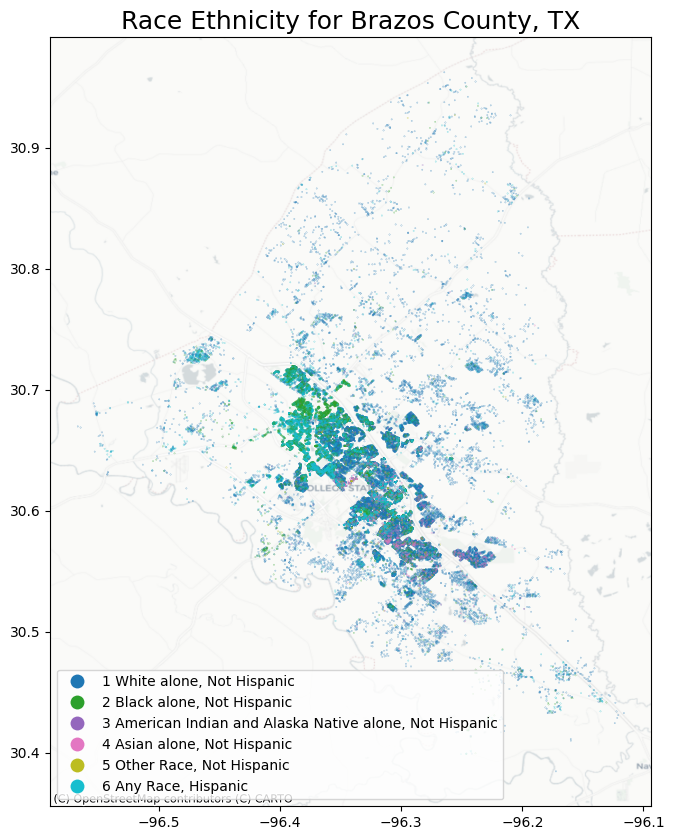

In [28]:
from pyncoda.ncoda_04b_foliummaps import *
# plot png file
from IPython.display import Image

bldg_inv_id = communities[community_id]['building_inventory']['id']
outputfolder = 'OutputData'
community = communities[community_id]['community_name']

county_map = plot_dotmap_map(gdf=county_hua_gdf,
                        mapname=mapname,
                        map_var=map_var,
                        bldg_inv_id=bldg_inv_id,
                        community=community_id,
                        place = community,
                        outputfolder=outputfolder,
                        condition_id = "1",
                        basemap_source = cx.providers.CartoDB.Positron)

In [29]:
# get xlim and ylim for focal place
xlim = [focal_place_hua_gdf.total_bounds[0], focal_place_hua_gdf.total_bounds[2]]
ylim = [focal_place_hua_gdf.total_bounds[1], focal_place_hua_gdf.total_bounds[3]]
print(xlim, ylim)

[-96.458106, -96.246157] [30.600807, 30.721939]


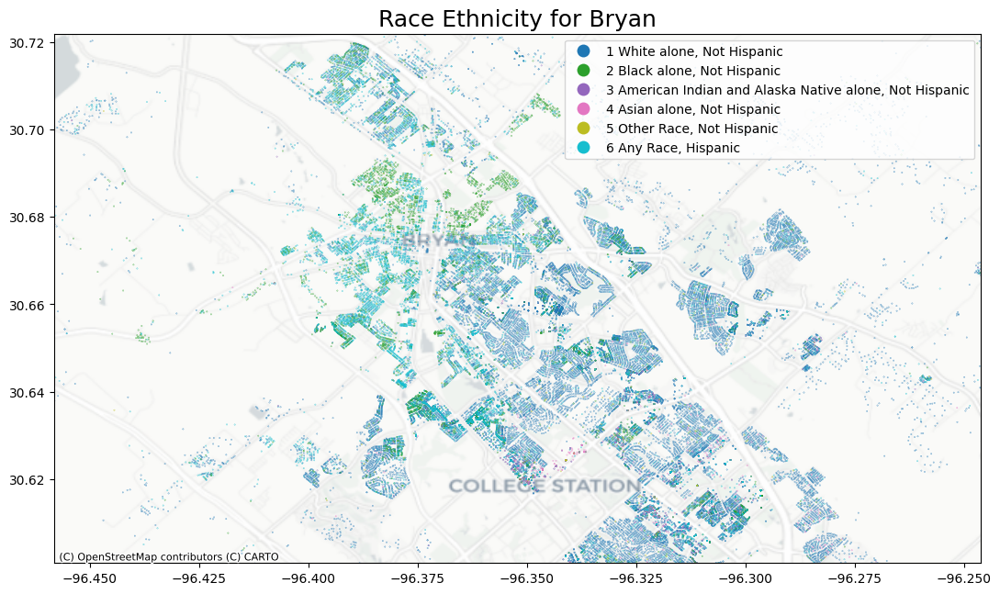

In [30]:

focal_place_map = plot_dotmap_map(gdf=county_hua_gdf,
                        mapname=mapname,
                        map_var=map_var,
                        bldg_inv_id=bldg_inv_id,
                        community=community_id,
                        place = focalplace,
                        outputfolder=outputfolder,
                        condition_id = "2",
                        basemap_source = cx.providers.CartoDB.Positron,
                        xlim = xlim,
                        ylim = ylim,
                        focal_gdf = focal_place_hua_gdf)

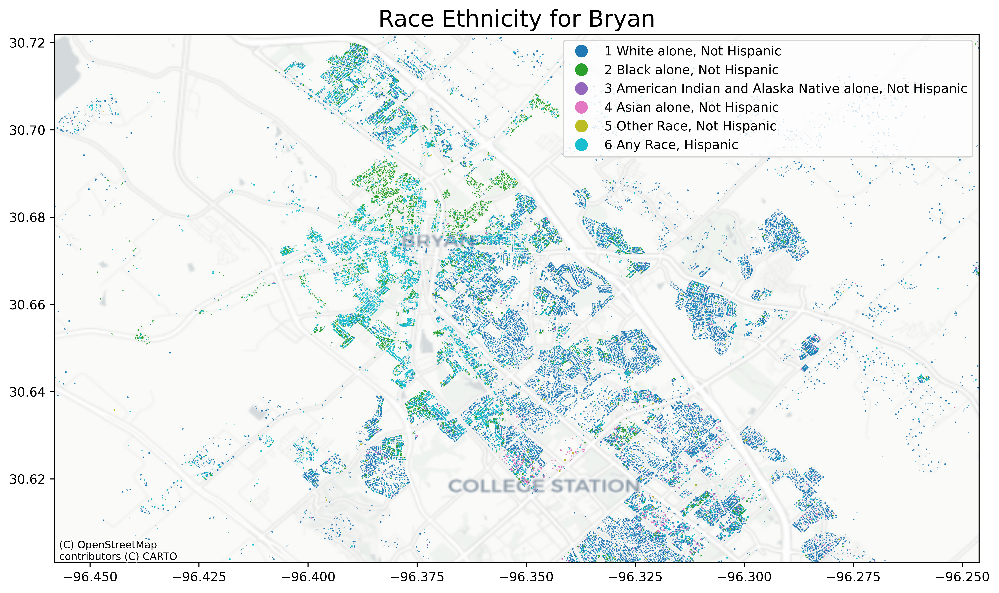

In [31]:
Image(focal_place_map+'.png', width= 800, height=800)

### Explore by Income

In [32]:
mapname = 'hhincdotmap'

# Map column
map_var = 'Household Income Group'

# Ensure 'hhinc' is numeric
hua_hui_race_gdf['hhinc'] = pd.to_numeric(hua_hui_race_gdf['hhinc'], errors='coerce')

condition1 = "(hua_hui_race_gdf.hhinc >= 1)"

county_hua_gdf = hua_hui_race_gdf.loc[eval(condition1)].copy(deep=True)
county_hua_gdf = county_hua_gdf.to_crs(epsg=4326)

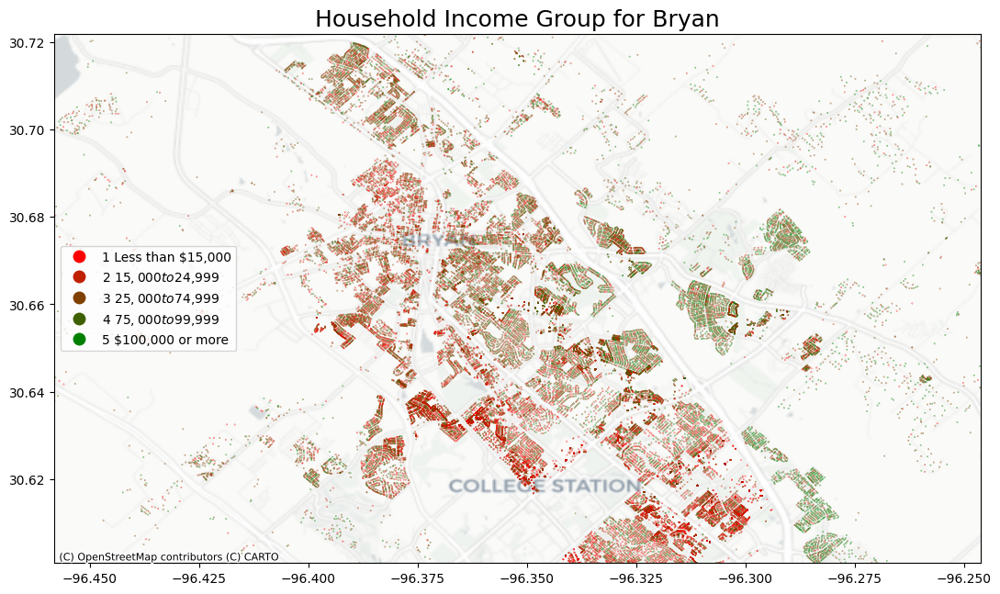

In [36]:
# get xlim and ylim for focal place
xlim = [focal_place_hua_gdf.total_bounds[0], focal_place_hua_gdf.total_bounds[2]]
ylim = [focal_place_hua_gdf.total_bounds[1], focal_place_hua_gdf.total_bounds[3]]

focal_place_map = plot_dotmap_map(gdf=county_hua_gdf,
                        mapname=mapname,
                        map_var=map_var,
                        bldg_inv_id=bldg_inv_id,
                        community=community_id,
                        place = focalplace,
                        outputfolder=outputfolder,
                        condition_id = "2",
                        basemap_source = cx.providers.CartoDB.Positron,
                        xlim = xlim,
                        ylim = ylim,
                        focal_gdf = focal_place_hua_gdf)

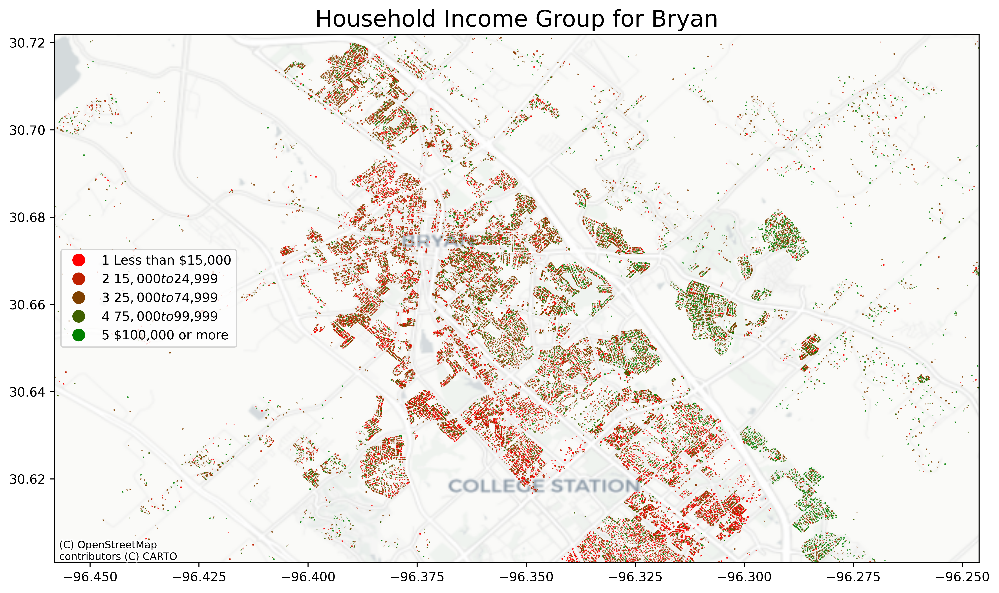

In [39]:
Image(focal_place_map+'.png', width= 800, height=800)

## View Codebook
The Housing Unit Allocation methodology generates a codebook for the housing unit inventory.

Look in the OutputData folder to find the codebook.